**Сердюк, 474б**

**Лабораторная 4.** Подключение библиотек, загрузка изображений и задание им одного размера

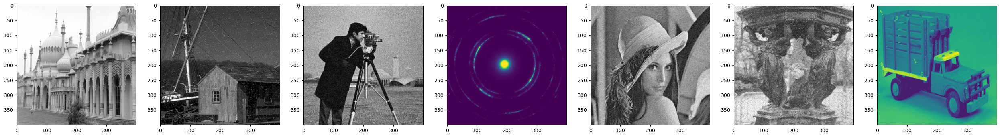

In [ ]:
from PIL import Image, ImageDraw, ImageOps
import matplotlib.pyplot as plt
import numpy as np

def draw_img(image):
  plt.figure(figsize=(5,5))
  plt.imshow(image)
  plt.show()

img_names = ['Bri.jpg','Building.jpg','Camera.jpg','Light.jpg','Noisy Lena.jpg','Statue.jpg','Truck.jpg']
i = 1
plt.figure(figsize=(35,5),dpi=90)
for n in img_names:
  image = Image.open(n) #Открываем изображение
  image = image.resize((400,400))
  plt.subplot(1,7,i)
  plt.imshow(image)
  i += 1
plt.show()


Применение фильтра cv2.blur к изображениям с различными размерами масок: 3x3, 5x5, 7x7 и 9x9. При таком фильтре убираются мелкие детали, что приводит к выделению более крупных объеков, но происходит замывание, из-за чего усложнаяется определение границ объектов. Анализ гистограмм не приводит к конкретным выводам, так как эффект зависит от изобажения. В некоторых убирается чёткая выраженность какого то оттенка, в других же, наоборот, некоторые оттенки начинают выделяться  

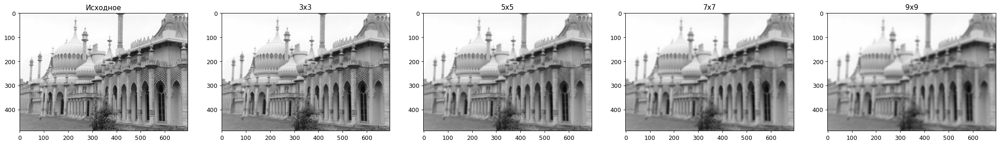

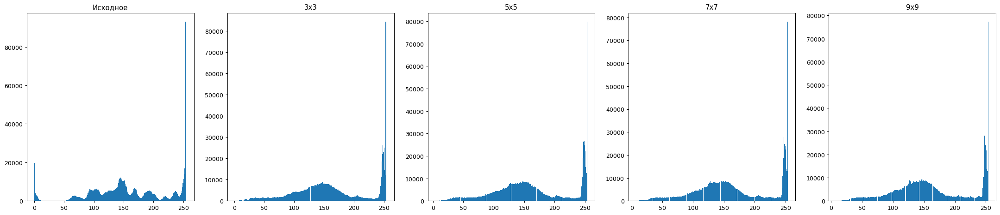

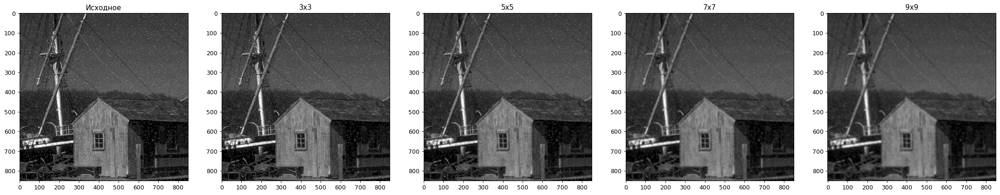

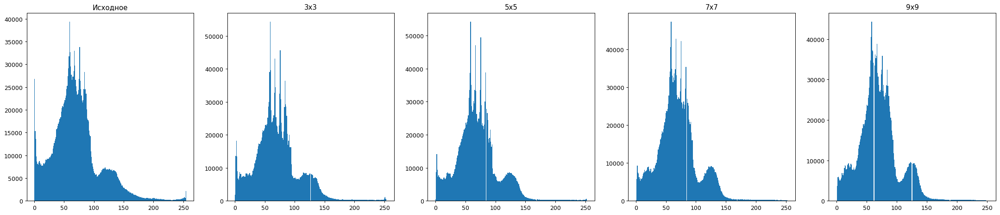

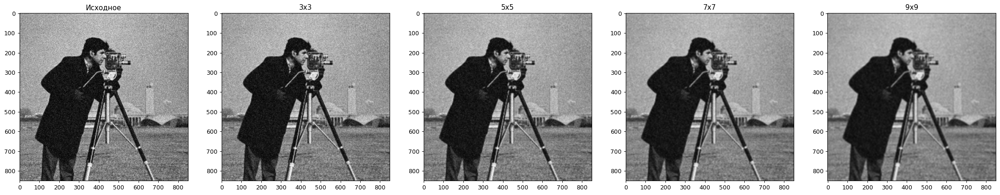

...

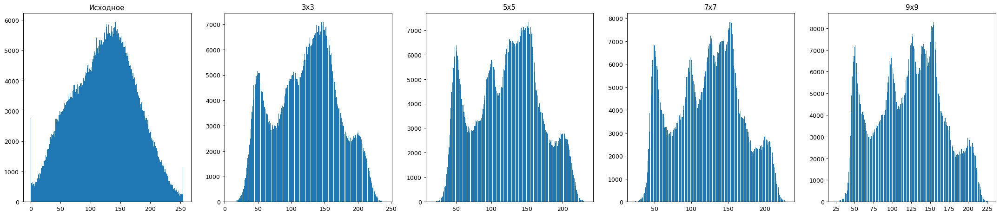

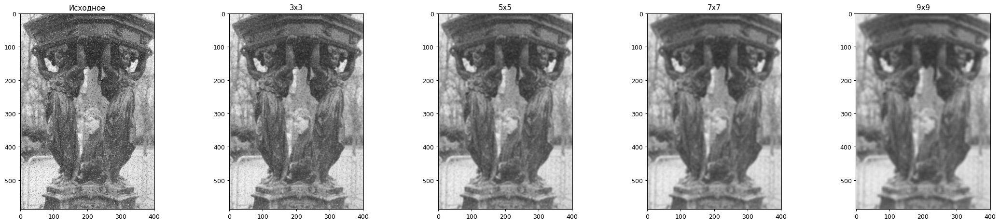

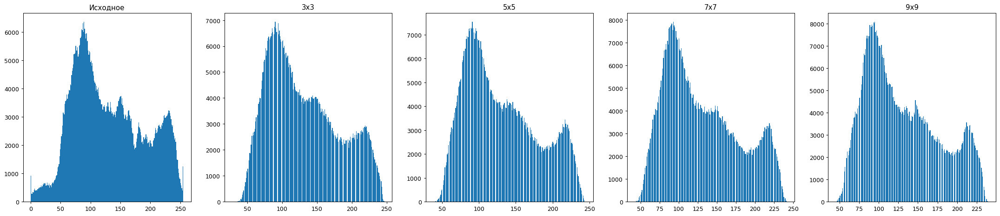

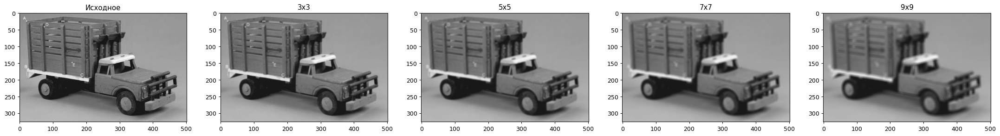

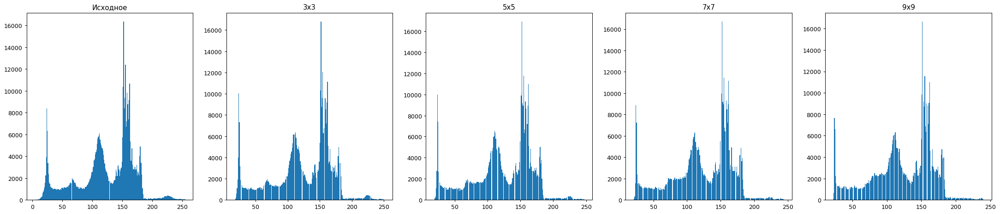

In [ ]:
import cv2

for n in img_names:
  image = cv2.imread(n)

  plt.figure(figsize=(30,6),dpi=90)
  k = 1
  plt.subplot(1,5,k)
  plt.title(label = 'Исходное')
  plt.imshow(image)
  k += 1
  for i in range(3,11,2):
    kernal_size = i
    new_image = cv2.blur(image,(kernal_size, kernal_size))
    plt.subplot(1,5,k)
    plt.title(label = str(kernal_size) +'x'+ str(kernal_size))
    plt.imshow(new_image)
    k += 1
  plt.show()

  plt.figure(figsize=(30,6),dpi=90)
  k = 1
  plt.subplot(1,5,k)
  plt.title(label = 'Исходное')
  plt.hist(np.ravel(image),bins=256)
  k += 1
  for i in range(3,11,2):
    kernal_size = i
    new_image = cv2.blur(image,(kernal_size, kernal_size))
    plt.subplot(1,5,k)
    plt.title(label = str(kernal_size) +'x'+ str(kernal_size))
    plt.hist(np.ravel(new_image),bins=256)
    k += 1
  plt.show()

Применение медианного фильтра cv2.medianBlur к изображениям с различными размерами масок: 3x3, 5x5, 7x7 и 9x9. В сравнении с предидущим фильтром, при уменьшении шума сохраняются границы объектов. Анализ гистограмм показывает выделение некоторых оттенков

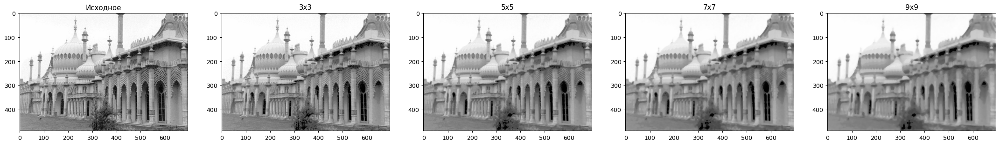

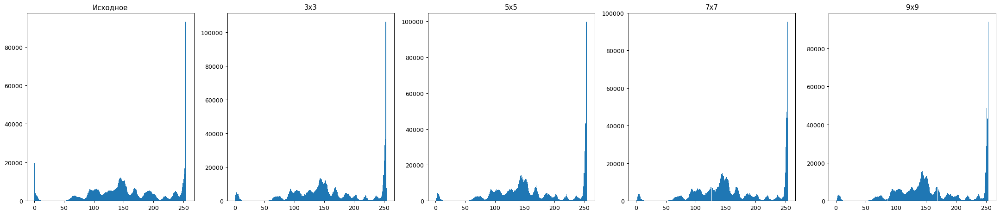

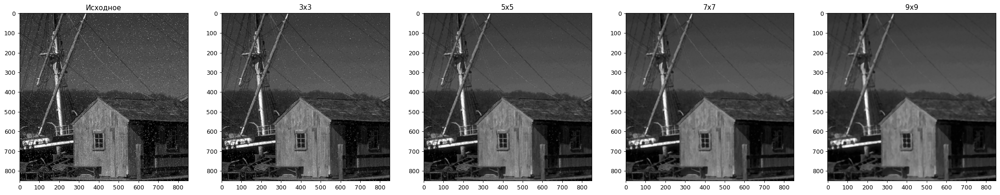

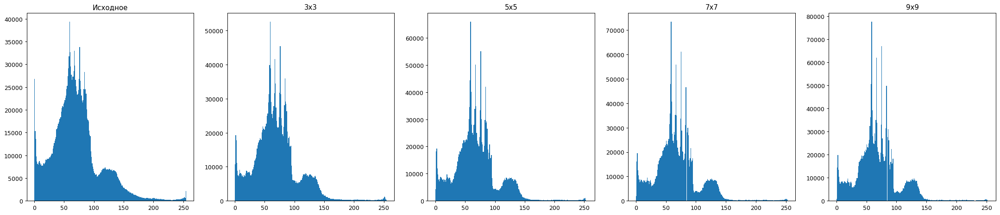

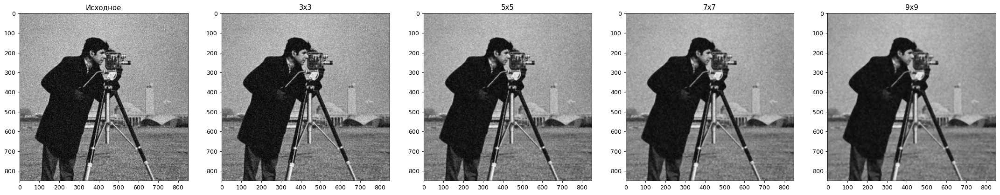

...

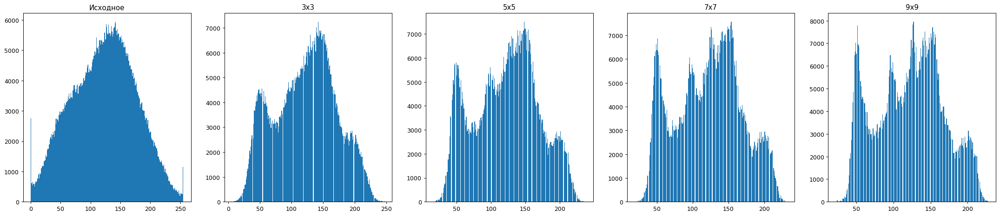

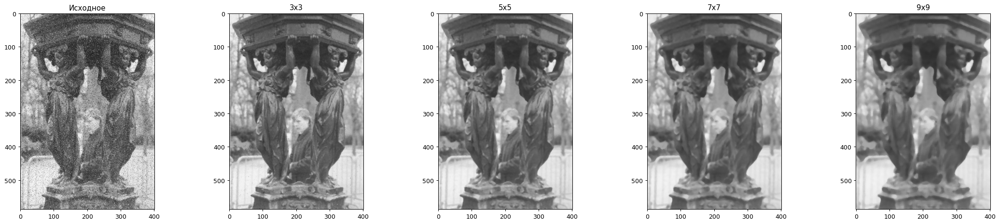

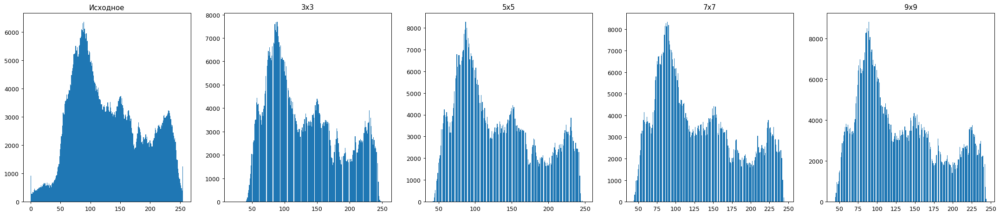

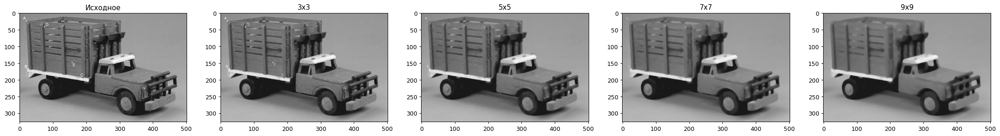

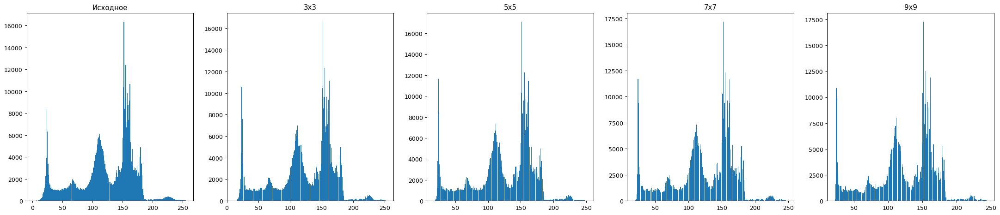

In [ ]:
import cv2

for n in img_names:
  image = cv2.imread(n)

  plt.figure(figsize=(30,6),dpi=90)
  k = 1
  plt.subplot(1,5,k)
  plt.title(label = 'Исходное')
  plt.imshow(image)
  k += 1
  for i in range(3,11,2):
    kernal_size = i
    new_image = cv2.medianBlur(image,kernal_size)
    plt.subplot(1,5,k)
    plt.title(label = str(kernal_size) +'x'+ str(kernal_size))
    plt.imshow(new_image)
    k += 1
  plt.show()

  plt.figure(figsize=(30,6),dpi=90)
  k = 1
  plt.subplot(1,5,k)
  plt.title(label = 'Исходное')
  plt.hist(np.ravel(image),bins=256)
  k += 1
  for i in range(3,11,2):
    kernal_size = i
    new_image = cv2.medianBlur(image,kernal_size)
    plt.subplot(1,5,k)
    plt.title(label = str(kernal_size) +'x'+ str(kernal_size))
    plt.hist(np.ravel(new_image),bins=256)
    k += 1
  plt.show()

Применение фильтра Гаусса cv2.GaussianBlur к изображениям с различными размерами масок: 3x3, 5x5, 7x7 и 9x9. Хорошо выделены крупные объекты, их границы сохранены, но шумы плохо справляется с шумами

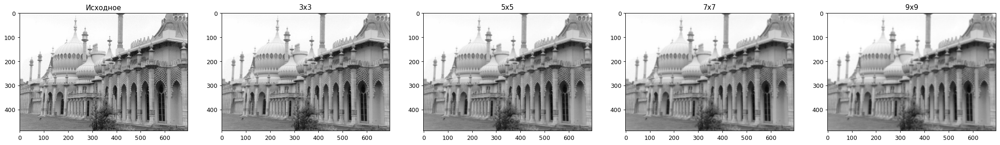

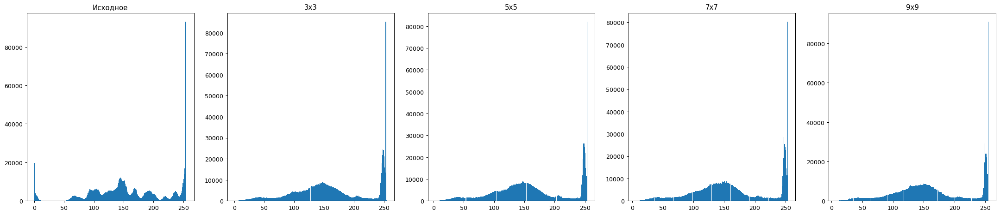

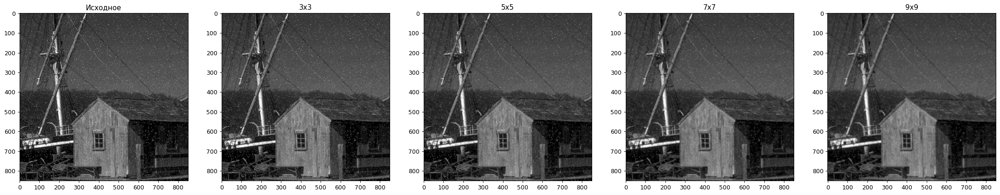

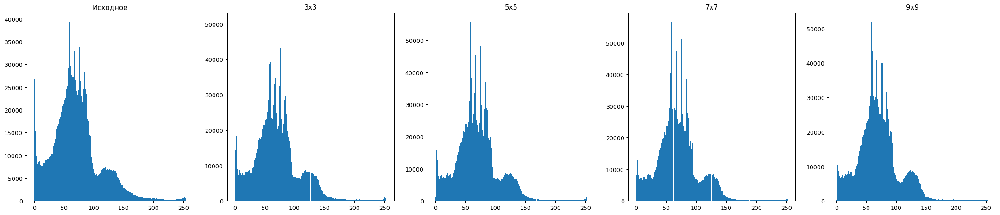

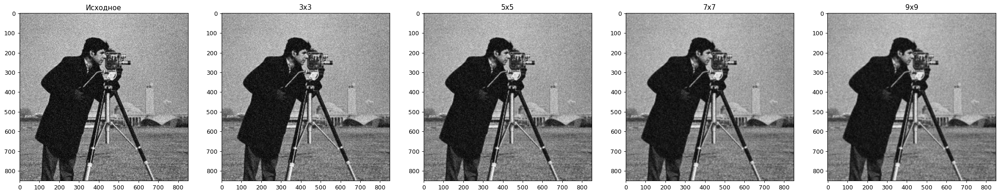

...

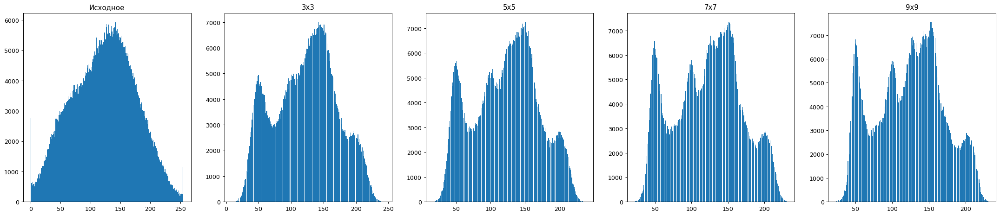

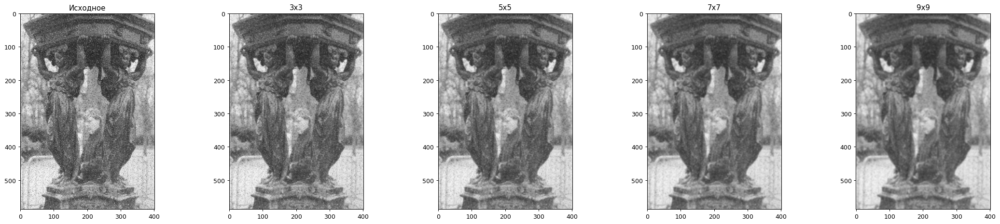

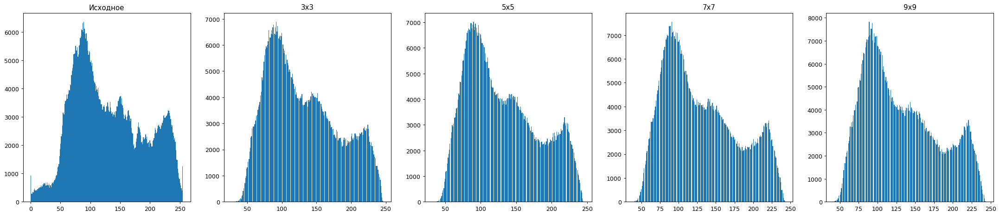

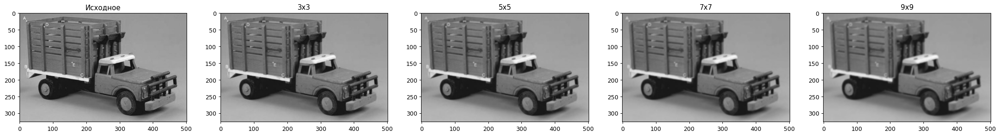

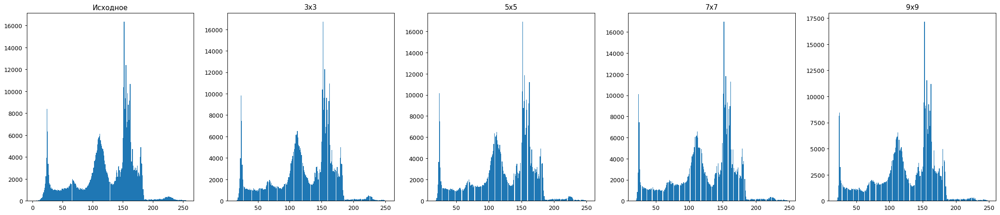

In [ ]:
import cv2

for n in img_names:
  image = cv2.imread(n)

  plt.figure(figsize=(30,6),dpi=90)
  k = 1
  plt.subplot(1,5,k)
  plt.title(label = 'Исходное')
  plt.imshow(image)
  k += 1
  for i in range(3,11,2):
    kernal_size = i
    new_image = cv2.GaussianBlur(image, (kernal_size,kernal_size),0)
    plt.subplot(1,5,k)
    plt.title(label = str(kernal_size)+'x'+str(kernal_size))
    plt.imshow(new_image)
    k += 1
  plt.show()

  plt.figure(figsize=(30,6),dpi=90)
  k = 1
  plt.subplot(1,5,k)
  plt.title(label = 'Исходное')
  plt.hist(np.ravel(image),bins=256)
  k += 1
  for i in range(3,11,2):
    kernal_size = i
    new_image = cv2.GaussianBlur(image, (kernal_size,kernal_size),0)
    plt.subplot(1,5,k)
    plt.title(label = str(kernal_size)+'x'+str(kernal_size))
    plt.hist(np.ravel(new_image),bins=256)
    k += 1
  plt.show()

Если необходимо просто убрать шумы, то лучше использовать медианный фильтр. Для выделения объектов лучше использовать Гауссов фильтр, если шумов нет или они незначительны. В противном случае можно использовать медианный фильтр, но качество изображение получится ниже

Фильтры с ядрами Собеля, Робертса и Превита позволяют выделять границы групных объектов на изображения. По гистограммам видно, что интенсивность переходит в сторону чёрного цвета с небольшим выделением белого. Причём у Собеля выделение наиболее явное, выделяются менее крупные объекты (например, изображение Bri). А у Робертса не такое явное, чт опозволяет выделить крупные объекты, игнорируя мелкие (например, изображение Camera). Ядро Превита является что-то средним между предыдущими, например, на изображении Truck оно показало лучший результат для выделения грузовика

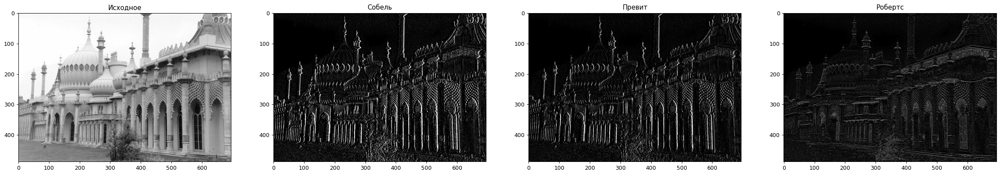

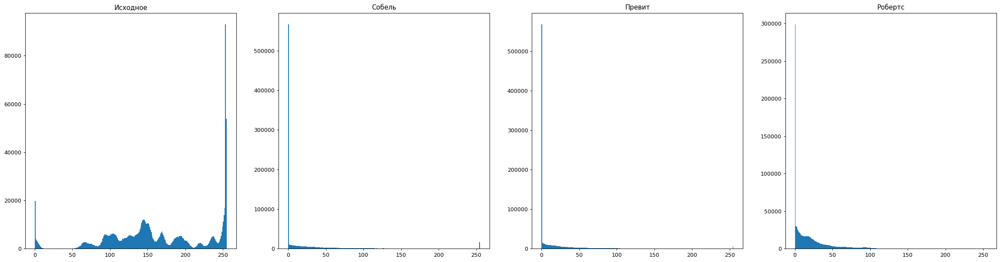

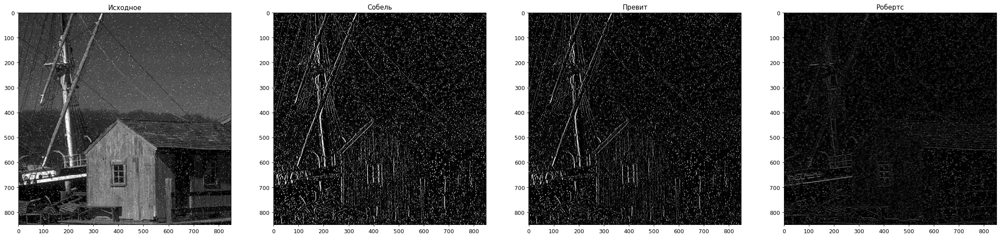

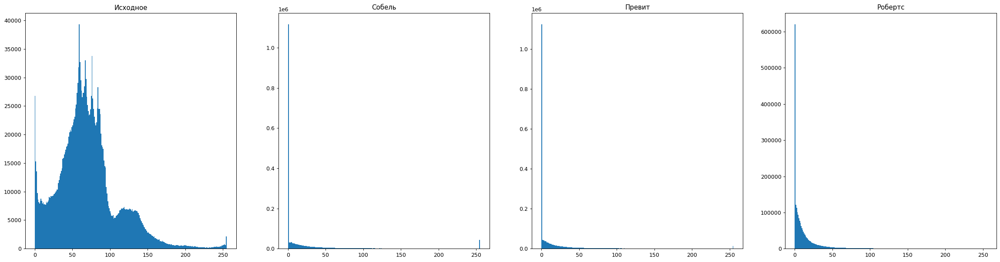

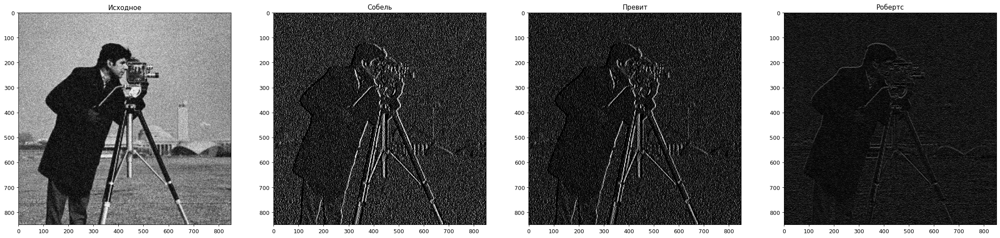

...

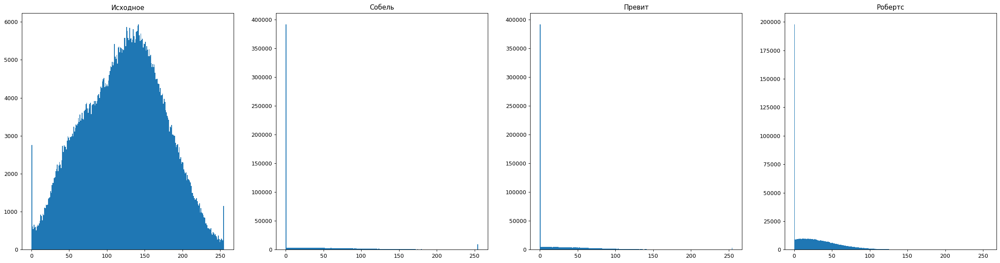

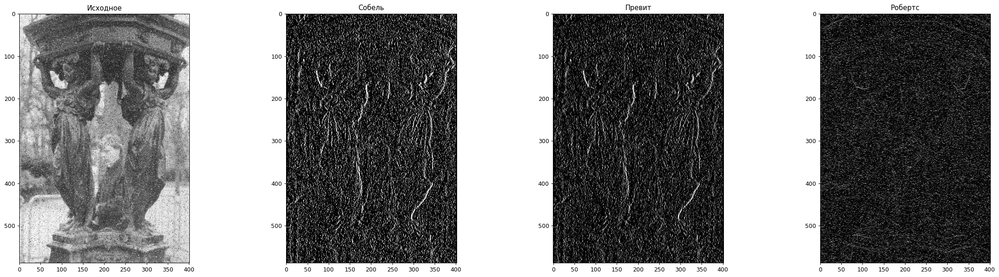

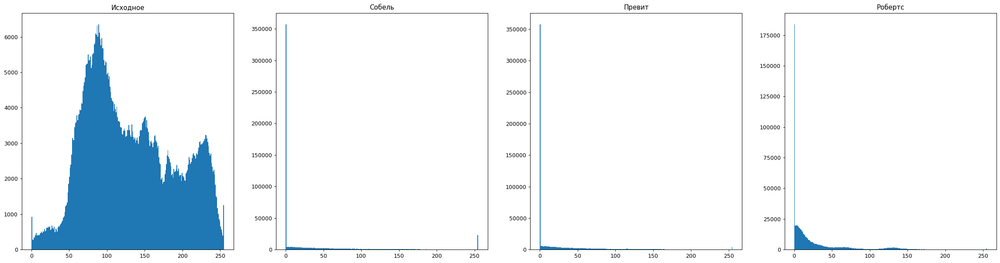

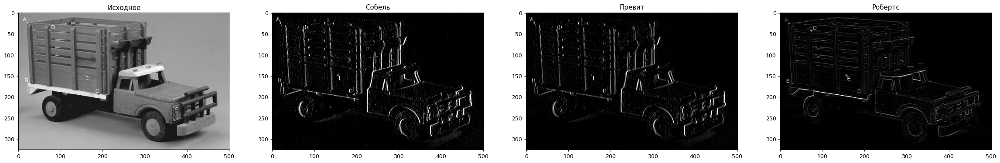

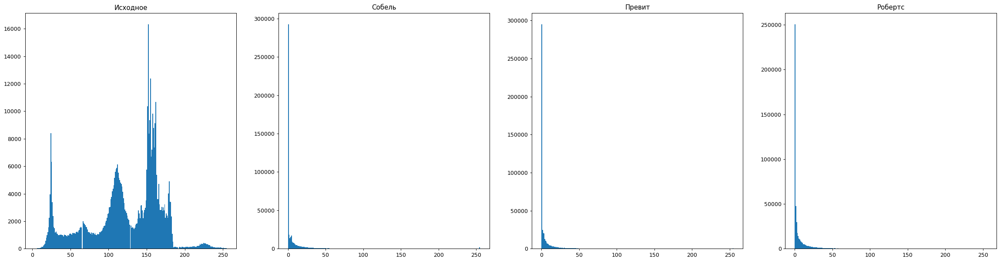

In [ ]:
SobelMtx = [[-1,0,1],[-2,0,2],[-1,0,1]]
PrevittaMtx = [[-1,0,1],[-1,0,1],[-1,0,1]]
RobertsMtx1 = [[1,0],[0,-1]]
RobertsMtx2 = [[0,1],[-1,-0]]

for n in img_names:

  image = cv2.imread(n)

  plt.figure(figsize=(32,8),dpi=90)
  plt.subplot(1,4,1)
  plt.title(label = 'Исходное')
  plt.imshow(image)

  kernel = np.array(SobelMtx, np.float32)# приведение ядра фильтра
  new_image = cv2.filter2D(image, -1, kernel)
  plt.subplot(1,4,2)
  plt.title(label = 'Собель')
  plt.imshow(new_image)
  
  kernel = np.array(PrevittaMtx, np.float32)# приведение ядра фильтра
  new_image = cv2.filter2D(image, -1, kernel)
  plt.subplot(1,4,3)
  plt.title(label = 'Превит')
  plt.imshow(new_image)

  kernel = np.array(RobertsMtx1, np.float32)
  new_img1 = cv2.filter2D(image,-1,kernel)
  kernel = np.array(RobertsMtx2, np.float32)
  new_img2 = cv2.filter2D(image,-1,kernel)
  new_image = cv2.add(new_img1,new_img2)
  plt.subplot(1,4,4)
  plt.title(label = 'Робертс')
  plt.imshow(new_image)

  plt.show()

  plt.figure(figsize=(32,8),dpi=90)
  plt.subplot(1,4,1)
  plt.title(label = 'Исходное')
  plt.hist(np.ravel(image),bins=256)

  kernel = np.array(SobelMtx, np.float32)# приведение ядра фильтра
  new_image = cv2.filter2D(image, -1, kernel)
  plt.subplot(1,4,2)
  plt.title(label = 'Собель')
  plt.hist(np.ravel(new_image),bins=256)
  
  kernel = np.array(PrevittaMtx, np.float32)# приведение ядра фильтра
  new_image = cv2.filter2D(image, -1, kernel)
  plt.subplot(1,4,3)
  plt.title(label = 'Превит')
  plt.hist(np.ravel(new_image),bins=256)

  kernel = np.array(RobertsMtx1, np.float32)
  new_img1 = cv2.filter2D(image,-1,kernel)
  kernel = np.array(RobertsMtx2, np.float32)
  new_img2 = cv2.filter2D(image,-1,kernel)
  new_image = cv2.add(new_img1,new_img2)
  plt.subplot(1,4,4)
  plt.title(label = 'Робертс')
  plt.hist(np.ravel(new_image),bins=256)

  plt.show()